# 05. Prep for Advanced Modelling and Exploring PCA

# Contents

1. Introduction
2. Train-test split
3. One-hot encoding and scaling features
4. Visualising class imbalance
5. Creating and applying a pipeline
6. Applying SMOTE
7. Visualising class imbalance after SMOTE
8. Exploring applying PCA for dimensionality reduction
9. Loadings for PC1 and PC2
10. Exploring how this extends to PC3
11. Summary and rationale for next steps

(Saving key variables)

# 1. Introduction

In the previous notebook, we established a baseline using logistic regression to predict the target variable. While this provided an essential benchmark for model performance, the dataset had certain limitations, such as **class imbalance** and **high dimensionality.** These factors likely influenced the baseline model's performance, potentially limiting its ability to accurately capture the relationships in the data.

To address these challenges, this notebook focuses on two key preprocessing steps:

* Class Balancing with SMOTE (Synthetic Minority Over-sampling Technique): In the baseline model, the class imbalance in the target variable likely affected the model’s ability to generalise well, particularly for the minority class. By applying SMOTE, we aim to balance the class distribution by generating synthetic samples for the minority class, thus allowing the model to learn better from underrepresented data.

* Dimensionality Reduction with PCA (Principal Component Analysis): The dataset contains a large number of features, which may introduce noise and redundancy. PCA is applied to reduce the dimensionality of the feature space, ensuring that the most important variance in the data is captured while minimising computational complexity and reducing potential overfitting.

In this notebook, we will:

* Apply SMOTE to the training data to balance the class distribution.
* Use PCA to reduce the dimensionality of the feature space.
* Prepare the transformed data for use in more advanced machine learning models, and evaluate the trade-off of using PCA.

These preprocessing steps are crucial for improving the performance of more complex models, which will be explored in subsequent notebooks.

First, let's import and essential libraries:

In [31]:
# Importing essential libraries
import pandas as pd          
import numpy as np         
import matplotlib.pyplot as plt  
import seaborn as sns
import plotly.graph_objs as go
import plotly.express as px
import os
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import classification_report
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA


Next let's load in our dataframe:

In [32]:
model1_df = pd.read_csv("../data_for_EDA/final_eda.csv")

And let's double check the datatypes in our df:

In [34]:
model1_df.dtypes

satisfaction_salary                  int64
satisfaction_advancement             int64
satisfaction_benefits                int64
satisfaction_challenges              int64
satisfaction_location                int64
satisfaction_security                int64
salary                             float64
importance_society_contribution      int64
job_degree_relation                  int64
recent_degree_field                 object
recent_degree_type                  object
age                                float64
marital_status                      object
citizenship_status                  object
children_in_household                int64
active_certifications              float64
survey_year                         object
occupation_name                     object
female                               int64
employer_sector                     object
employer_size_category              object
employer_region                     object
respondent_region                   object
ethnicity  

There's one column we forgot to drop which is likely redundant - we can drop citizenship_status which hold the same info as whether someone is a us citizen or not. This is also the case for survey_year vs survey date which was used for the purpose of constructing the job_duration_months variable, rather than being important as a standalone.

We'll keep in survey_year, given what we saw in our EDA about the potential impact of Covid on job satisfaction.

In [35]:
model1_df.drop(columns=['citizenship_status', 'survey_date'], inplace=True)

Now, we're ready to proceed to address our key preprocessing gaps.

# 2. Train, test split

First, assigning our X and y, remembering that our target is predicting 'high job satisfaction':

In [36]:
X = model1_df.drop('high_jobsat', axis=1)
y = model1_df['high_jobsat']

Split into train and test, ensuring to stratify data to ensure class distribution is the same in both the training and testing sets. We will also use 30% of data for testing:

In [37]:
# Train-test split with stratification based on 'high_jobsat'
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify=y)

# 3. One-hot encoding and scaling

As we saw with our datatypes earlier, we will need to ensure all data is of the appropriate datatype (numeric) for advanced modelling. We will use sklearn's Column Transformer to support with this, naming this as a 'preprocessor':

In [38]:
# Detect categorical and numerical features
categorical_features = X.select_dtypes(include=['object', 'category']).columns.tolist()
numerical_features = X.select_dtypes(exclude=['object']).columns.tolist()  # Select all non-object columns as numerical

Checking what these categorical features are:

In [39]:
categorical_features

['recent_degree_field',
 'recent_degree_type',
 'marital_status',
 'survey_year',
 'occupation_name',
 'employer_sector',
 'employer_size_category',
 'employer_region',
 'respondent_region',
 'ethnicity']

In [40]:
numerical_features

['satisfaction_salary',
 'satisfaction_advancement',
 'satisfaction_benefits',
 'satisfaction_challenges',
 'satisfaction_location',
 'satisfaction_security',
 'salary',
 'importance_society_contribution',
 'job_degree_relation',
 'age',
 'children_in_household',
 'active_certifications',
 'female',
 'job_duration_months',
 'us_citizen']

Applying a ColumnTransformer pipeline to handle sclaing and one-hot encoding for categorical vars:

In [41]:
# Use ColumnTransformer to handle scaling for numeric and one-hot encoding for categorical; handle_unkown lets us safely handle unseen categories when it comes to the test data
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numerical_features),  # Scale numeric features
        ('cat', OneHotEncoder(drop='first',handle_unknown='ignore', sparse_output=False), categorical_features)  # One-hot encode categorical features, ensuring drop first is set to true
    ]
)

# 4. Visualising class imbalance before SMOTE ('Synthetic Minority Over-sampling Technique')


Before addressing class imbalance, it's important to remind ourselves of the class imbalance to understand how skewed the data is:

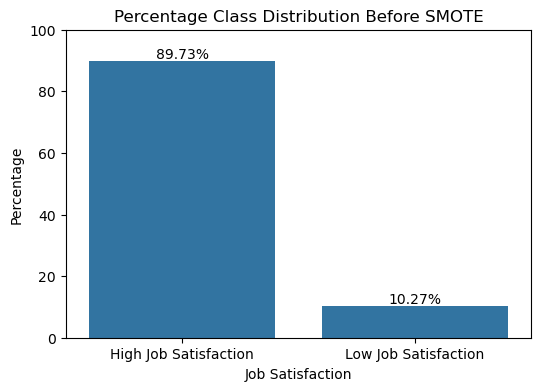

In [42]:
# Calculate percentage distribution for y_train
class_counts = y_train.value_counts(normalize=True) * 100

# Map the values to labels
class_counts.index = class_counts.index.map({1: 'High Job Satisfaction', 0: 'Low Job Satisfaction'})

# Plot the percentage class distribution
plt.figure(figsize=(6,4))
sns.barplot(x=class_counts.index, y=class_counts.values)
plt.title('Percentage Class Distribution Before SMOTE')
plt.xlabel('Job Satisfaction')
plt.ylabel('Percentage')
plt.ylim(0, 100)
for index, value in enumerate(class_counts.values):
    plt.text(index, value + 1, f'{value:.2f}%', ha='center')  # Adding percentage labels on bars
plt.show()

#### As we've seen in previous notebooks, our data has high class imbalance with nearly 90% of data falling into the positive class, compared to 10% in the negative or ('low job satisfaction') class.

# 5. Creating and applying a pipeline, ready for applying SMOTE:

We can create a machine learnng pipeline to help us with encoding and scaling the data - without any application of SMOTE or PCA yet:

(https://stackoverflow.com/questions/48369464/imbalanced-classification-order-of-oversampling-vs-scaling-features)

In [43]:
preprocess_pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),  # Apply the ColumnTransformer for one-hot encoding
])

Fitting this pipeline on **train** data only, and then transforming both the train and test datasets:

In [44]:
X_train_scaled = preprocess_pipeline.fit_transform(X_train)
X_test_scaled = preprocess_pipeline.transform(X_test)  # Scale test set using the same scaler

What does the shape of this dataset look like now?

In [45]:
X_train_scaled.shape

(206726, 325)

X_train now has ~206,726 rows and 325 columns - meaning a significant increase in dimensionality.

# 6. Applying SMOTE to the training data

SMOTE (Synthetic Minority Over-sampling Technique) generates synthetic samples for the minority class to balance the data. We will apply SMOTE only to the training set to prevent data leakage.

We can use the `imbalanced_learn` package to help us with this:

In [46]:
# Import library
from imblearn.over_sampling import SMOTE

# Apply SMOTE to the scaled training data
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_scaled, y_train)


# 7. Visualising class imbalance after SMOTE

Let's check what the class imbalance now looks like after applying SMOTE to the training set:

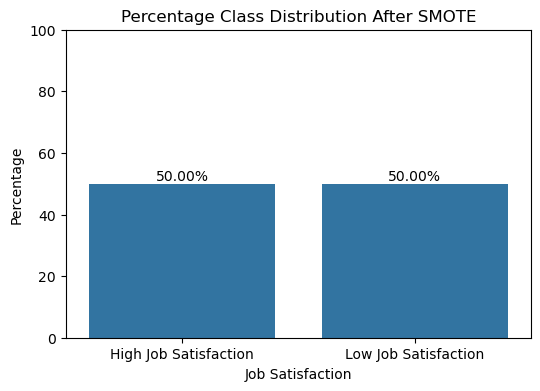

In [47]:
# Step 3: After applying SMOTE, plot the class distribution of the resampled training data
class_counts_resampled = pd.Series(y_train_resampled).value_counts(normalize=True) * 100

# Map the values to labels
class_counts_resampled.index = class_counts_resampled.index.map({1: 'High Job Satisfaction', 0: 'Low Job Satisfaction'})

# Plot the percentage class distribution after SMOTE
plt.figure(figsize=(6,4))
sns.barplot(x=class_counts_resampled.index, y=class_counts_resampled.values)
plt.title('Percentage Class Distribution After SMOTE')
plt.xlabel('Job Satisfaction')
plt.ylabel('Percentage')
plt.ylim(0, 100)
for index, value in enumerate(class_counts_resampled.values):
    plt.text(index, value + 1, f'{value:.2f}%', ha='center')  # Adding percentage labels on bars
plt.show()

In [48]:
X_train_resampled.shape

(370990, 325)

#### We can see above that the number of rows have increased after applying SMOTE, to 370,990.

#### We can now see we've generated a balanced dataset, which will help address our model's fit to unseen data

# 8. Explore applying PCA for dimensionality reduction

We will explore applying principal component analysis to reduce the dimensionality of our dataset.

It transformation (such as scaling, one-hot encoding, or PCA) applied to the training data must also be applied to the test data. The model is trained on preprocessed features, so the test data needs to be transformed in the same way to match the training data's feature space.

To clarify, this means:

1. PCA should now be applied to both the resampled training data (post-SMOTE) and the scaled test data (without SMOTE, but after encoding and scaling).
2. Our pipeline will only need PCA at this stage, since encoding and scaling were handled earlier.

### (a) Creating and applying a pipeline with PCA only, with a focus on explaining 90% variance:

#### This will involve fitting PCA on the resampled training data, and **transforming** both train and test data:

In [49]:
# Initialise PCA
pca = PCA()

# Fit PCA on the preprocessed, resampled training data
pca.fit(X_train_resampled)

# Transform the training and test data using the fitted pipeline
X_train_pca = pca.transform(X_train_resampled)
X_test_pca = pca.transform(X_test_scaled)

# Step 5: Output the explained variance ratio by PCA
explained_variance = pca.explained_variance_ratio_

# Calculate cumulative explained variance
cumulative_explained_variance = explained_variance.cumsum()

# Step 6: Find the number of components required to explain 90% of the variance
n_components_90 = next(i for i, total_var in enumerate(cumulative_explained_variance) if total_var >= 0.90) + 1

# Output the result
print(f'Number of components explaining 90% of the variance: {n_components_90}')


Number of components explaining 90% of the variance: 30


#### It looks like 30 components explain 90% of our variance in the dataset.

#### We can plot this on a graph, seeing how explained variance until it reaches the 30 components and beyond:

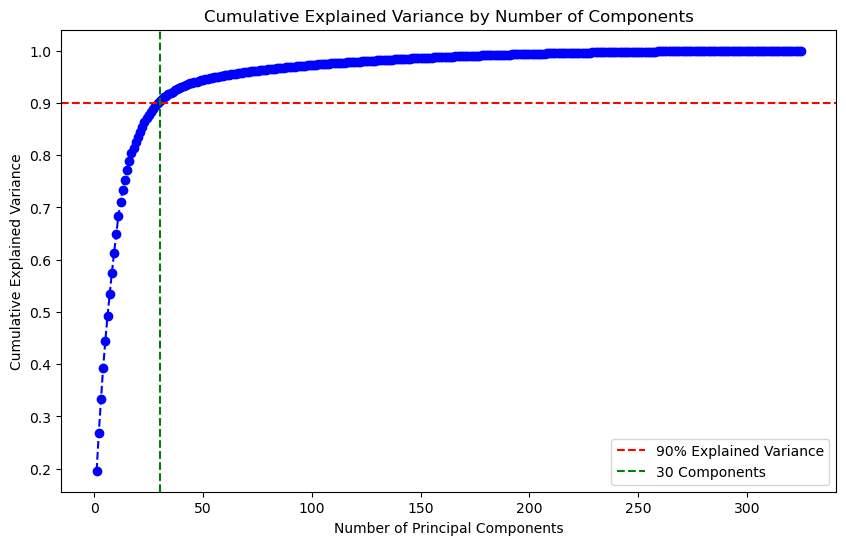

In [50]:
# Plot the cumulative explained variance
plt.figure(figsize=(10,6))
plt.plot(range(1, len(cumulative_explained_variance) + 1), cumulative_explained_variance, marker='o', linestyle='--', color='b')
plt.axhline(y=0.90, color='r', linestyle='--', label='90% Explained Variance')
plt.axvline(x=n_components_90, color='g', linestyle='--', label=f'{n_components_90} Components')
plt.title('Cumulative Explained Variance by Number of Components')
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.legend(loc='best')
plt.show()

### Key takeways from the Scree Plot

* The scree plot shows both the individual explained variance of each principal component and the cumulative explained variance as more components are added.

* From the plot, it loks like a large number of components are reuqired to explain a sufficient amount of th evariance (i.e., the 90% mark). 

* Whilst we might have expected a sharper elbow, we see that the sumulative variance line is increasing quite steadily, and variance is more evenly distirbuted across components than may have been expected with other datasets.

* This means that out of 325 features, 30 components are sufficient to retain 90% of the data’s variance. Reducing the dimensionality to 248 still captures most of the information, which can help in simplifying the model while retaining performance.

* The tail of the plot starts to flatten after this, which means that the remaining components add very little additional information.

# 9. Loadings for PC1 and PC2

### (a) It would be helpful to gain a sense of the feature importance, by inspecting the loadings from e.g., components PC1 and PC2:

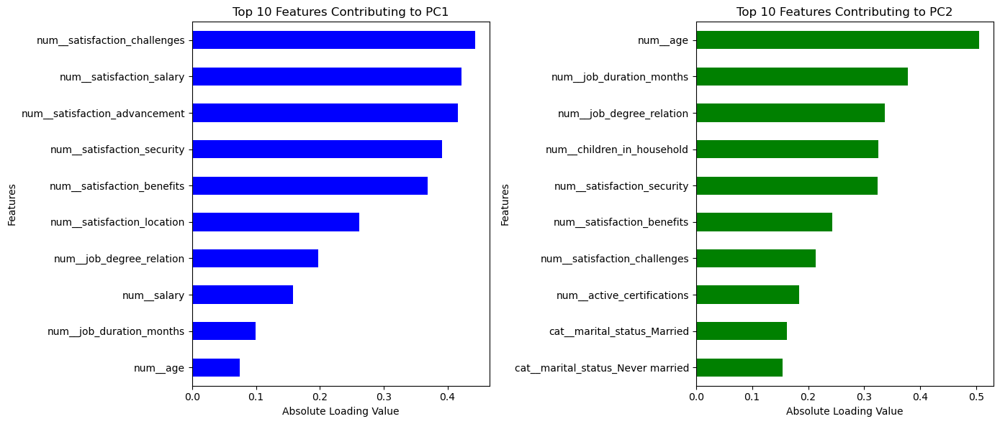

In [51]:
# Since we've applied PCA using the pca_pipeline, extract the components
pca_components = pca.components_

# # Get the feature names (after one-hot encoding) if they were used in pre-processing
feature_names = preprocessor.get_feature_names_out()

# Create a DataFrame for easy interpretation
pca_df = pd.DataFrame(pca_components, columns=feature_names)

# Get the absolute value of the loadings (important for feature importance)
abs_pca_df = np.abs(pca_df)

# Identify the top contributing features for the first principal component (PC1)
top_features_pc1 = abs_pca_df.iloc[0].sort_values(ascending=False)[:10]
# print("Top 10 Features Contributing to PC1:")
# print(top_features_pc1)

# Identify the top contributing features for the second principal component (PC2)
top_features_pc2 = abs_pca_df.iloc[1].sort_values(ascending=False)[:10]
# print("\nTop 10 Features Contributing to PC2:")
# print(top_features_pc2)

# Plot PC1 and PC2 side by side
fig, axes = plt.subplots(ncols=2, figsize=(14, 6))

# PC1 (with features as the vertical labels and horizontal bars for loading values)
top_features_pc1.plot(kind='barh', color='blue', ax=axes[0])
axes[0].set_title('Top 10 Features Contributing to PC1')
axes[0].set_ylabel('Features')
axes[0].set_xlabel('Absolute Loading Value')
axes[0].invert_yaxis()  # Ensures the highest loading feature appears at the top

# PC2 (with features as the vertical labels and horizontal bars for loading values)
top_features_pc2.plot(kind='barh', color='green', ax=axes[1])
axes[1].set_title('Top 10 Features Contributing to PC2')
axes[1].set_ylabel('Features')
axes[1].set_xlabel('Absolute Loading Value')
axes[1].invert_yaxis()  # Ensures the highest loading feature appears at the top

# Adjust layout for better spacing
plt.tight_layout()
plt.show()


### Key takeways regarding PC loadings:

### 1. PC1

### (a) Features relating to aspects of job satisfaction are all dominant contributors to PC1.

* These features are directly related to different dimensions of job satisfaction. 
* Since our target is high job satisfaction, PC1 likely captures the primary drivers of satisfaction, such as compensation, professional challenges, career advancement, job security, and benefits.

### (b) Marital status may be correlated with high job satisfaction, or it may affect how individuals perceive certain aspects of their job, such as stability, work-life balance, or compensation

* This could explain what we saw in our baseline logit model, in terms of being married being associated with higher odds of being highly satisfied in one's job.

### 2. PC2

### (a) We see satisfaction with salary appears again in PC2

* PC2 includes features like employer sector, region which may be associated with different salary levels based on the region or industry. 
* Therefore, salary could be indirectly related to these factors as well, which would explain why it contributes to PC2.

### (b) Active certifications, children in houshold

* These are some of the more tradiitonal feature variables that we'd expect to see - these appear in PC2 suggesting feature importance in relation to job satisfaction.


# 10. Exploring how this extends to PC3, using a 3d visualisation

In [52]:
# Import necessary libary
import plotly.express as px

#  three principal components are in X_train_pca
X_train_pc1 = X_train_pca[:, 0]
X_train_pc2 = X_train_pca[:, 1]
X_train_pc3 = X_train_pca[:, 2]

# Create a DataFrame for easier plotting with Plotly
pca_df = pd.DataFrame({
    'PC1': X_train_pc1,
    'PC2': X_train_pc2,
    'PC3': X_train_pc3,
    'Target': y_train_resampled  # Binary target variable (high job satisfaction)
})

# Map the binary target variable to 'High Job Satisfaction' and 'Low Job Satisfaction' labels
pca_df['Target'] = pca_df['Target'].map({1: 'High Job Satisfaction', 0: 'Low Job Satisfaction'})

# Create the 3D scatter plot using Plotly with distinct colors
fig = px.scatter_3d(pca_df, x='PC1', y='PC2', z='PC3', color='Target',
                    title='Interactive 3D Scatter Plot of First Three Principal Components',
                    labels={'Target': 'Target Variable'},  # Update the label for the legend
                    color_discrete_map={'High Job Satisfaction': 'blue', 'Low Job Satisfaction': 'orange'})  # Use discrete color map

# Show the interactive plot
fig.show()


## Key takeaways

* Each axis (PC1, PC2, PC3) shows how much variance is explained by each respective component. Together, these components should capture a significant amount of the dataset's variability.

* A clear separation suggests that the principal components effectively distinguish between the two classes. Given some of the colours are mixed, it indicates overlap between the two groups.

* First three principal components do not completely separate individuals with high job satisfaction from those with low job satisfaction, which makes sense given the explained variance analysis we did earlier.

* In the upper ranges of PC3 (above 4 on the z-axis), there is a concentration of blue points (High Job Satisfaction), and fewer orange points (Low Job Satisfaction) are seen there. This suggests that PC3 is capturing more information about High Job Satisfaction than PC1 and PC2 are.

# 11. Summary and rationale for next steps

In this notebook, we addressed the class imbalance in the training data using SMOTE, followed by Principal Component Analysis (PCA) for dimensionality reduction. After applying SMOTE to the training data, we explored how the first three principal components contributed to separating the high and low job satisfaction classes. Based on the cumulative explained variance, we determined that retaining 30 principal components was sufficient to explain 90% of the variance in the data.

While PCA proved to be a valuable technique for dimensionality reduction and optimisation of the logistic regression model, **interpretability** remains a key factor in our analysis. PCA transforms the features into a new space, making it difficult to directly interpret the original variables, which is critical for understanding the drivers of job satisfaction in this context.

As we move forward with more advanced models, such as the Decision Tree, we can take advantage of built-in methods for feature selection and feature importance without relying on PCA. Decision Trees allow us to:

Retain the original feature space, making the results more interpretable.
Automatically select the most important features by learning hierarchical splits, which is beneficial for reducing overfitting and improving generalization.
Given that interpretability is crucial in this project, and Decision Trees provide both flexibility in handling non-linear relationships and insights into feature importance, we will opt to skip PCA for the upcoming models. Instead, we will use the model's inherent capabilities to balance accuracy and interpretability.

In the next notebook, we will begin by constructing our first advanced model: the Decision Tree. This will allow us to refine our approach to feature selection and evaluate the model's performance across various hyperparameters ([Proceed to Model 2: Decision Tree](../notebooks/06%20Model%202%20-%20Decision%20Tree.ipynb))



*********

## Saving key variables:

### Saving feature data as a dataframe for easier access later on:

In [54]:
# Convert X_train_resampled (NumPy array) to a DataFrame using the extracted feature names
X_train_resampled_df = pd.DataFrame(X_train_resampled, columns=feature_names)

# Check the shape to ensure it's correct
print(X_train_resampled_df.shape)


(370990, 325)


In [55]:
X_test_scaled_df = pd.DataFrame(X_test_scaled, columns=feature_names)
# Check the shape to ensure it's correct
print(X_test_scaled_df.shape)

(88597, 325)


### Joblib dump to load these preporcessed variables later on:

In [56]:
# Using joblib to help with this
import joblib

# Save the training and test data (X) as dataframes
joblib.dump(X_train_resampled_df, '../preprocessed_variables/X_train_resampled_df.pkl')  # Save the resampled X_train (after SMOTE)
joblib.dump(X_test_scaled_df, '../preprocessed_variables/X_test_scaled_df.pkl')          # Save the scaled X_test

# Save the corresponding target variables
joblib.dump(y_train_resampled, '../preprocessed_variables/y_train_resampled.pkl')  # Save the resampled y_train
joblib.dump(y_test, '../preprocessed_variables/y_test.pkl')                        # Save y_test (o changes to y_test)


['../preprocessed_variables/y_test.pkl']